In [100]:
import os
from datetime import datetime, timedelta
import pandas as pd
import plotly.express as px
from scipy import stats
import plotly.graph_objects as go
import statsmodels.api as sm
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

In [2]:
# Set the directory for where files are located
kwargs = {}

kwargs['io_dir'] = 'bis_data'
kwargs['plots_dir'] = 'plots'

## Load CPI (Inflation) data 

<div class="alert alert-block alert-danger">
You need to download this dataset using the link below
</div>

Source:

https://data.bis.org/topics/CPI/data

Go the export button and then to the 'bulk downloads' tab in order to download the flat CSV

In [3]:
cpi_df = pd.read_csv(os.path.join(kwargs['io_dir'], 'WS_LONG_CPI_csv_flat.csv'))

## Load Central bank Policy Rates (Interest rates)

<div class="alert alert-block alert-danger">
You need to download this dataset using the link below as it can easily be >100mb if you choose 
    all countries.
</div>

Source:

https://data.bis.org/topics/CBPOL/data?q=%22BIS+Central+Bank+Policy+Rates%22

Go the export button and then to the 'bulk downloads' tab in order to download the flat CSV

In [4]:
cb_df = pd.read_csv(os.path.join(kwargs['io_dir'], 'WS_CBPOL_csv_flat.csv'))

/tmp/ipykernel_26/415999144.py:1: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  cb_df = pd.read_csv(os.path.join(kwargs['io_dir'], 'WS_CBPOL_csv_flat.csv'))


In [5]:
cb_df.columns = [i.lower() for i in cb_df.columns]

In [6]:
cb_df.head()

,structure,structure_id,action,freq:frequency,ref_area:reference area,time_period:time period or range,obs_value:observation value,unit_measure:unit of measure,unit_mult:unit multiplier,time_format:time format,compilation:compilation,decimals:decimals,source_ref:publication source,supp_info_breaks:supplemental information and breaks,title:title,obs_status:observation status,obs_conf:observation confidentiality,obs_pre_break:pre-break observation
0,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,D: Daily,CA: Canada,1960-07-27,3.44,368: Per cent per year,0: Units,NaN,"From 1 Jun 1994 onwards: Central Bank target, ...",4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Daily - ...,A: Normal value,F: Free,NaN
1,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,D: Daily,CA: Canada,1960-07-28,3.17,368: Per cent per year,0: Units,NaN,"From 1 Jun 1994 onwards: Central Bank target, ...",4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Daily - ...,A: Normal value,F: Free,NaN
2,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,D: Daily,CA: Canada,1960-07-29,3.17,368: Per cent per year,0: Units,NaN,"From 1 Jun 1994 onwards: Central Bank target, ...",4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Daily - ...,A: Normal value,F: Free,NaN
3,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,D: Daily,CA: Canada,1960-07-30,NaN,368: Per cent per year,0: Units,NaN,"From 1 Jun 1994 onwards: Central Bank target, ...",4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Daily - ...,M: Missing value; data cannot exist,F: Free,NaN
4,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,D: Daily,CA: Canada,1960-07-31,NaN,368: Per cent per year,0: Units,NaN,"From 1 Jun 1994 onwards: Central Bank target, ...",4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Daily - ...,M: Missing value; data cannot exist,F: Free,NaN


In [7]:
# df2.columns = df.iloc[2]

## Load Private Debt and Reference Data

Source: 

Download 'Credit to the non-financial sector'

https://www.bis.org/statistics/totcredit.htm?m=2669


In [8]:
cred_df = pd.read_excel(os.path.join(kwargs['io_dir'], 'totcredit.xlsx'), sheet_name='Quarterly Series')

In [9]:
new_cols = cred_df.iloc[2]

In [10]:
cred_df = cred_df.iloc[3:]
cred_df.columns = new_cols
cred_df.head()

2,Period,Q:4T:C:A:M:770:A,Q:4T:C:A:M:799:A,Q:4T:C:A:M:USD:A,Q:4T:G:A:N:770:A,Q:4T:G:A:N:799:A,Q:4T:G:A:N:USD:A,Q:4T:H:A:M:770:A,Q:4T:H:A:M:799:A,Q:4T:H:A:M:USD:A,...,Q:ZA:N:A:M:XDC:A,Q:ZA:N:A:M:XDC:U,Q:ZA:P:A:M:770:A,Q:ZA:P:A:M:USD:A,Q:ZA:P:A:M:XDC:A,Q:ZA:P:A:M:XDC:U,Q:ZA:P:B:M:770:A,Q:ZA:P:B:M:USD:A,Q:ZA:P:B:M:XDC:A,Q:ZA:P:B:M:XDC:U
3,1940-06-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1940-09-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,1940-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,1941-03-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,1941-06-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
# This reference data sheet is provide dbut originally obtained from the BIS site
ref = pd.read_excel(os.path.join(kwargs['io_dir'], 'totcredit.xlsx'), sheet_name='Summary Documentation')

In [12]:
ref.head()

,Data set,Code,Frequency,Borrowers' country,Borrowing sector,Lending sector,Valuation method,Unit type,Adjustment,Unit,Unit multiplier,Collection Indicator,Decimals,Series title
0,BIS_TC2,Q:4T:C:A:M:770:A,Quarterly,Emerging market economies (aggregate),Non financial sector,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...
1,BIS_TC2,Q:4T:C:A:M:799:A,Quarterly,Emerging market economies (aggregate),Non financial sector,All sectors,Market value,Percentage of GDP (using PPP exchange rates),Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...
2,BIS_TC2,Q:4T:C:A:M:USD:A,Quarterly,Emerging market economies (aggregate),Non financial sector,All sectors,Market value,US dollar,Adjusted for breaks,US dollar,Billions,End of period,Three,Emerging market economies (aggregate) - Credit...
3,BIS_TC2,Q:4T:G:A:N:770:A,Quarterly,Emerging market economies (aggregate),General government,All sectors,Nominal value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...
4,BIS_TC2,Q:4T:G:A:N:799:A,Quarterly,Emerging market economies (aggregate),General government,All sectors,Nominal value,Percentage of GDP (using PPP exchange rates),Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...


# Pre-processing

## Process central bank policy for interest rate

In [14]:
def process_cb_date(x):

    '''
    Handle inconsistent date notation in column
    '''

    try:
        x2 = pd.to_datetime(x, utc=True)
        return x2
        
    except Exception as e:
        if len(str(x)) == 7:
            x2 = pd.to_datetime(x, format='%Y-%m', utc=True)
            return x2
        elif (len(str(x)) == 4) & int(x) > 1800:
            x2 = pd.to_datetime(x, format='%Y', utc=True)
            
        else:
            print('Unknown format: %s' %(x))

In [15]:
# Process the time period column in to something pandas can work with:
cb_df['cb_policy_date'] = cb_df['time_period:time period or range'].apply(process_cb_date)

In [16]:
cb_df['cb_policy_date'] = pd.to_datetime(cb_df['cb_policy_date'], utc=True)

In [17]:
cb_df['freq:frequency'].unique()

array(['D: Daily', 'M: Monthly'], dtype=object)

In [18]:
# Extract the country codes and names:
cb_df['country_code'] = cb_df['ref_area:reference area'].apply(lambda x: x[0:2])
cb_df['country_name'] = cb_df['ref_area:reference area'].apply(lambda x: x[4:])

In [19]:
# Extract monthly data only
m_cb_df =cb_df[cb_df['freq:frequency'] == 'M: Monthly'].copy()

In [20]:
# Quick QC check:
assert len(m_cb_df['unit_measure:unit of measure'].unique()) == 1

In [21]:
m_cb_df.head()

,structure,structure_id,action,freq:frequency,ref_area:reference area,time_period:time period or range,obs_value:observation value,unit_measure:unit of measure,unit_mult:unit multiplier,time_format:time format,...,decimals:decimals,source_ref:publication source,supp_info_breaks:supplemental information and breaks,title:title,obs_status:observation status,obs_conf:observation confidentiality,obs_pre_break:pre-break observation,cb_policy_date,country_code,country_name
22271,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,M: Monthly,CA: Canada,1960-07,3.17,368: Per cent per year,0: Units,NaN,...,4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Monthly ...,A: Normal value,F: Free,NaN,1960-07-01 00:00:00+00:00,CA,Canada
22272,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,M: Monthly,CA: Canada,1960-08,2.50,368: Per cent per year,0: Units,NaN,...,4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Monthly ...,A: Normal value,F: Free,NaN,1960-08-01 00:00:00+00:00,CA,Canada
22273,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,M: Monthly,CA: Canada,1960-09,1.95,368: Per cent per year,0: Units,NaN,...,4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Monthly ...,A: Normal value,F: Free,NaN,1960-09-01 00:00:00+00:00,CA,Canada
22274,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,M: Monthly,CA: Canada,1960-10,3.28,368: Per cent per year,0: Units,NaN,...,4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Monthly ...,A: Normal value,F: Free,NaN,1960-10-01 00:00:00+00:00,CA,Canada
22275,dataflow,BIS:WS_CBPOL(1.0): Policy rate,I,M: Monthly,CA: Canada,1960-11,4.02,368: Per cent per year,0: Units,NaN,...,4: Four,Bank of Canada,In Jun 1994 the Bank of Canada (BoC) began shi...,Central bank policy rates - Canada - Monthly ...,A: Normal value,F: Free,NaN,1960-11-01 00:00:00+00:00,CA,Canada


## Process CPI

In [22]:
# Lower all column names
cpi_df.columns = [i.lower() for i in cpi_df.columns]

In [23]:
# Extract country codes and country names
cpi_df['country_code'] = cpi_df['ref_area:reference area'].apply(lambda x: x[0:2])
cpi_df['country_name'] = cpi_df['ref_area:reference area'].apply(lambda x: x[4:])

In [24]:
# Process the time period column in to something pandas can work with. Ignore unknown date formats:
cpi_df['cpi_date'] = cpi_df['time_period:time period or range'].apply(process_cb_date)

Unknown format: 1662
Unknown format: 1663
Unknown format: 1664
Unknown format: 1665
Unknown format: 1666
Unknown format: 1667
Unknown format: 1668
Unknown format: 1669
Unknown format: 1670
Unknown format: 1671
Unknown format: 1672
Unknown format: 1673
Unknown format: 1674
Unknown format: 1675
Unknown format: 1676
Unknown format: 1677
Unknown format: 1661
Unknown format: 1662
Unknown format: 1663
Unknown format: 1664
Unknown format: 1665
Unknown format: 1666
Unknown format: 1667
Unknown format: 1668
Unknown format: 1669
Unknown format: 1670
Unknown format: 1671
Unknown format: 1672
Unknown format: 1673
Unknown format: 1674
Unknown format: 1675
Unknown format: 1676
Unknown format: 1677


In [25]:
# Rename 
assert len(cpi_df['structure_id'].unique()) == 1
cpi_df = cpi_df.rename(columns={'obs_value:observation value': 'cpi_value'})

In [26]:
cpi_df.head()

,structure,structure_id,action,freq:frequency,ref_area:reference area,unit_measure:unit of measure,time_period:time period or range,cpi_value,unit_mult:unit multiplier,time_format:time format,breaks:breaks,coverage:coverage,decimals:decimals,title_ts:title (tseries level),obs_conf:observation confidentiality,obs_pre_break:pre-break observation,obs_status:observation status,country_code,country_name,cpi_date
0,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1981,101.736627,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1981-01-01 00:00:00+00:00
1,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1982,100.573712,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1982-01-01 00:00:00+00:00
2,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1983,135.020056,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1983-01-01 00:00:00+00:00
3,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1984,192.120739,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1984-01-01 00:00:00+00:00
4,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1985,226.029296,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1985-01-01 00:00:00+00:00


## Process Credit data

In [27]:
cred_df.head(n=2)

2,Period,Q:4T:C:A:M:770:A,Q:4T:C:A:M:799:A,Q:4T:C:A:M:USD:A,Q:4T:G:A:N:770:A,Q:4T:G:A:N:799:A,Q:4T:G:A:N:USD:A,Q:4T:H:A:M:770:A,Q:4T:H:A:M:799:A,Q:4T:H:A:M:USD:A,...,Q:ZA:N:A:M:XDC:A,Q:ZA:N:A:M:XDC:U,Q:ZA:P:A:M:770:A,Q:ZA:P:A:M:USD:A,Q:ZA:P:A:M:XDC:A,Q:ZA:P:A:M:XDC:U,Q:ZA:P:B:M:770:A,Q:ZA:P:B:M:USD:A,Q:ZA:P:B:M:XDC:A,Q:ZA:P:B:M:XDC:U
3,1940-06-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1940-09-30 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
p_cred_stack_df = cred_df.set_index('Period').stack().reset_index()
p_cred_stack_df.columns = ['period','code','cred_value']

In [29]:
p_cred_stack_df['pcred_end_period'] = p_cred_stack_df['period'].apply(process_cb_date)

In [30]:
ref.columns = [i.lower() for i in ref.columns]

In [31]:
ref_lookup = ref.set_index('code').to_dict()

In [32]:
p_cred_stack_df['borrower_country_name'] = p_cred_stack_df['code'].map(ref_lookup["borrowers' country"])

In [33]:
p_cred_stack_df

,period,code,cred_value,pcred_end_period,borrower_country_name
0,1940-06-30,Q:AR:P:A:M:XDC:A,0.0,1940-06-30 00:00:00+00:00,Argentina
1,1940-06-30,Q:AR:P:A:M:XDC:U,0.0,1940-06-30 00:00:00+00:00,Argentina
2,1940-06-30,Q:AR:P:B:M:XDC:A,0.0,1940-06-30 00:00:00+00:00,Argentina
3,1940-06-30,Q:AR:P:B:M:XDC:U,0.0,1940-06-30 00:00:00+00:00,Argentina
4,1940-09-30,Q:AR:P:A:M:XDC:A,0.0,1940-09-30 00:00:00+00:00,Argentina
...,...,...,...,...,...
172031,2022-12-31,Q:ZA:P:A:M:XDC:U,4462.802,2022-12-31 00:00:00+00:00,South Africa
172032,2022-12-31,Q:ZA:P:B:M:770:A,57.6,2022-12-31 00:00:00+00:00,South Africa
172033,2022-12-31,Q:ZA:P:B:M:USD:A,224.925,2022-12-31 00:00:00+00:00,South Africa
172034,2022-12-31,Q:ZA:P:B:M:XDC:A,3816.642,2022-12-31 00:00:00+00:00,South Africa


In [34]:
ref["borrowers' country"].unique()

array(['Emerging market economies (aggregate)',
       'All reporting countries (aggregate)',
       'Advanced economies (aggregate)', 'Argentina', 'Austria',
       'Australia', 'Belgium', 'Brazil', 'Canada', 'Switzerland', 'Chile',
       'China', 'Colombia', 'Czechia', 'Germany', 'Denmark', 'Spain',
       'Finland', 'France', 'G20 (aggregate)', 'United Kingdom', 'Greece',
       'Hong Kong SAR', 'Hungary', 'Indonesia', 'Ireland', 'Israel',
       'India', 'Italy', 'Japan', 'Korea', 'Luxembourg', 'Mexico',
       'Malaysia', 'Netherlands', 'Norway', 'New Zealand', 'Poland',
       'Portugal', 'Russia', 'Saudi Arabia', 'Sweden', 'Singapore',
       'Thailand', 'Türkiye', 'United States', 'Euro area',
       'South Africa'], dtype=object)

In [35]:
p_cred_stack_df['frequency'] = p_cred_stack_df['code'].map(ref_lookup["frequency"])

In [36]:
p_cred_stack_df['credit_unit_type'] = p_cred_stack_df['code'].map(ref_lookup["unit type"])

In [37]:
p_cred_stack_df['lending_sector'] = p_cred_stack_df['code'].map(ref_lookup["lending sector"])

In [38]:
p_cred_stack_df['borrowing_sector'] = p_cred_stack_df['code'].map(ref_lookup["borrowing sector"])

In [39]:
p_cred_stack_df['valuation_method'] = p_cred_stack_df['code'].map(ref_lookup["valuation method"])

In [40]:
ref['unit type'].unique()

array(['Percentage of GDP',
       'Percentage of GDP (using PPP exchange rates)', 'US dollar',
       'Domestic currency (incl. conv. to current ccy made using a fix parity)'],
      dtype=object)

In [41]:
ref[(ref["borrowers' country"] == 'United Kingdom') & (ref['lending sector'] == 'All sectors') & (ref['unit type'] == 'Percentage of GDP')]

,data set,code,frequency,borrowers' country,borrowing sector,lending sector,valuation method,unit type,adjustment,unit,unit multiplier,collection indicator,decimals,series title
469,BIS_TC2,Q:GB:C:A:M:770:A,Quarterly,United Kingdom,Non financial sector,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to Non financial secto...
472,BIS_TC2,Q:GB:G:A:M:770:A,Quarterly,United Kingdom,General government,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to General government ...
475,BIS_TC2,Q:GB:G:A:N:770:A,Quarterly,United Kingdom,General government,All sectors,Nominal value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to General government ...
478,BIS_TC2,Q:GB:H:A:M:770:A,Quarterly,United Kingdom,Households and NPISHs,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to Households and NPIS...
482,BIS_TC2,Q:GB:N:A:M:770:A,Quarterly,United Kingdom,Non-financial corporations,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to Non-financial corpo...
486,BIS_TC2,Q:GB:P:A:M:770:A,Quarterly,United Kingdom,Private non-financial sector,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,United Kingdom - Credit to Private non-financi...


In [42]:
ref.head(n=2)

,data set,code,frequency,borrowers' country,borrowing sector,lending sector,valuation method,unit type,adjustment,unit,unit multiplier,collection indicator,decimals,series title
0,BIS_TC2,Q:4T:C:A:M:770:A,Quarterly,Emerging market economies (aggregate),Non financial sector,All sectors,Market value,Percentage of GDP,Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...
1,BIS_TC2,Q:4T:C:A:M:799:A,Quarterly,Emerging market economies (aggregate),Non financial sector,All sectors,Market value,Percentage of GDP (using PPP exchange rates),Adjusted for breaks,Per cent,Units,End of period,One,Emerging market economies (aggregate) - Credit...


In [43]:
# p_cred_stack_df[p_cred_stack_df['country_code'].isnull()]['borrower_country_name'].unique()

## Merge CPI, Central Bank and Private Data in to one Time Series

In [44]:
cpi_df['freq:frequency'].unique()

array(['A: Annual', 'M: Monthly'], dtype=object)

In [45]:
cpi_df.head(n=2)

,structure,structure_id,action,freq:frequency,ref_area:reference area,unit_measure:unit of measure,time_period:time period or range,cpi_value,unit_mult:unit multiplier,time_format:time format,breaks:breaks,coverage:coverage,decimals:decimals,title_ts:title (tseries level),obs_conf:observation confidentiality,obs_pre_break:pre-break observation,obs_status:observation status,country_code,country_name,cpi_date
0,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1981,101.736627,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1981-01-01 00:00:00+00:00
1,dataflow,BIS:WS_LONG_CPI(1.0): BIS long consumer prices,I,A: Annual,BR: Brazil,"771: Year-on-year changes, in per cent",1982,100.573712,0: Units,NaN,NaN,NaN,NaN,NaN,F: Free,NaN,A: Normal value,BR,Brazil,1982-01-01 00:00:00+00:00


In [46]:
country_name_to_code_lookup = cpi_df.groupby(['country_name'])['country_code'].first().to_dict()
p_cred_stack_df['country_code'] = p_cred_stack_df['borrower_country_name'].map(country_name_to_code_lookup)

In [47]:
p_cred_stack_df.head(n=2)

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,country_code
0,1940-06-30,Q:AR:P:A:M:XDC:A,0.0,1940-06-30 00:00:00+00:00,Argentina,Quarterly,Domestic currency (incl. conv. to current ccy ...,All sectors,Private non-financial sector,Market value,AR
1,1940-06-30,Q:AR:P:A:M:XDC:U,0.0,1940-06-30 00:00:00+00:00,Argentina,Quarterly,Domestic currency (incl. conv. to current ccy ...,All sectors,Private non-financial sector,Market value,AR


In [48]:
p_cred_stack_df['pcred_end_period'] = pd.to_datetime(p_cred_stack_df['pcred_end_period'], utc=True)
cpi_df['cpi_date'] = pd.to_datetime(cpi_df['cpi_date'], utc=True)

In [49]:
# Process date to align p_cred with cpi index dates
cpi_df['cpi_date_prior_month'] = cpi_df['cpi_date'] - pd.DateOffset(months=1)
cpi_df['cpi_year'] = cpi_df['cpi_date_prior_month'].dt.year
cpi_df['cpi_month'] = cpi_df['cpi_date_prior_month'].dt.month

p_cred_stack_df['pcred_end_period_year'] = p_cred_stack_df['pcred_end_period'].dt.year
p_cred_stack_df['pcred_end_period_month'] = p_cred_stack_df['pcred_end_period'].dt.month

In [50]:
m_cb_df['period'] = pd.to_datetime(m_cb_df['time_period:time period or range'], utc=True)
m_cb_df['cb_period_month'] = m_cb_df['period'].dt.month
m_cb_df['cb_period_year'] = m_cb_df['period'].dt.year

In [51]:
# Filter down the cpi index to focus on pct
cpi_pct_df = cpi_df[cpi_df['unit_measure:unit of measure'] == '771: Year-on-year changes, in per cent'].copy()

In [52]:
p_cred_stack_df['lending_sector'].unique()

array(['All sectors', 'Banks, total'], dtype=object)

In [53]:
# Filter down the p_cred to focus on pct of GDP
unit_type = 'Percentage of GDP'
p_cred_stack_pct_df = p_cred_stack_df[p_cred_stack_df['credit_unit_type'] == unit_type].copy()

# Filter down the p_cred to focus on pct of GDP
lending_sector = 'All sectors'
p_cred_stack_pct_df = p_cred_stack_pct_df[p_cred_stack_pct_df['lending_sector'] == lending_sector].copy()

borrwing_sectors = ['Private non-financial sector', 'Non financial sector', 'General government', 'Households and NPISHs',
                    'Non-financial corporations']

borrowing_sector = 'Private non-financial sector'

valuation_methods = ['Market value', 'Nominal value']

In [54]:
# Merge cpi data on to p_Cred_stack
sliced = cpi_pct_df[['cpi_year', 'cpi_date_prior_month', 'cpi_month','country_name', 'cpi_value',]]
before = p_cred_stack_pct_df.shape[0]
p_cred_stack_pct_df2 = p_cred_stack_pct_df.merge(sliced, left_on=['pcred_end_period_year', 'pcred_end_period_month', 'borrower_country_name'],
                                        right_on=['cpi_year', 'cpi_month', 'country_name'], how='left')
after = p_cred_stack_pct_df2.shape[0]
print(before, after)

# Null check
print(p_cred_stack_pct_df2['cpi_value'].isnull().sum())

36968 45412
2631


In [55]:
p_cred_stack_pct_df2[p_cred_stack_pct_df2['borrower_country_name'] == 'United Kingdom'].head()

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,country_code,pcred_end_period_year,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value
715,1963-03-31,Q:GB:P:A:M:770:A,55.4,1963-03-31 00:00:00+00:00,United Kingdom,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,GB,1963,3,1963.0,1963-03-01 00:00:00+00:00,3.0,United Kingdom,2.197802
740,1963-06-30,Q:GB:P:A:M:770:A,54.7,1963-06-30 00:00:00+00:00,United Kingdom,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,GB,1963,6,1963.0,1963-06-01 00:00:00+00:00,6.0,United Kingdom,1.086957
765,1963-09-30,Q:GB:P:A:M:770:A,53.9,1963-09-30 00:00:00+00:00,United Kingdom,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,GB,1963,9,1963.0,1963-09-01 00:00:00+00:00,9.0,United Kingdom,2.197802
795,1963-12-31,Q:GB:P:A:M:770:A,52.7,1963-12-31 00:00:00+00:00,United Kingdom,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,GB,1963,12,1963.0,1963-12-01 00:00:00+00:00,12.0,United Kingdom,3.228700
796,1963-12-31,Q:GB:P:A:M:770:A,52.7,1963-12-31 00:00:00+00:00,United Kingdom,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,GB,1963,12,1963.0,1963-12-01 00:00:00+00:00,12.0,United Kingdom,2.173913


In [56]:
# p_cred_stack_df2[~p_cred_stack_df2['cpi_value'].isnull()]['pcred_end_period'].unique()

## Quality Control

### Query unique values

In [57]:
ref['unit type'].unique()

array(['Percentage of GDP',
       'Percentage of GDP (using PPP exchange rates)', 'US dollar',
       'Domestic currency (incl. conv. to current ccy made using a fix parity)'],
      dtype=object)

In [58]:
p_cred_stack_df['borrowing_sector'].unique()

array(['Private non-financial sector', 'Non financial sector',
       'General government', 'Households and NPISHs',
       'Non-financial corporations'], dtype=object)

In [59]:
p_cred_stack_df['valuation_method'].unique()

array(['Market value', 'Nominal value'], dtype=object)

In [60]:
ref['lending sector'].unique()

array(['All sectors', 'Banks, total'], dtype=object)

### Inflation

In [61]:
p_cred_stack_pct_df2[p_cred_stack_pct_df2['country_name'] == 'United States']

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,country_code,pcred_end_period_year,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value
0,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
1,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
2,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
3,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
4,1947-12-31,Q:US:G:A:N:770:A,93.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45396,2022-12-31,Q:US:G:A:M:770:A,103.1,2022-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,United States,6.410147
45397,2022-12-31,Q:US:G:A:N:770:A,111.9,2022-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,US,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,United States,6.410147
45398,2022-12-31,Q:US:H:A:M:770:A,74.4,2022-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Households and NPISHs,Market value,US,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,United States,6.410147
45399,2022-12-31,Q:US:N:A:M:770:A,78.1,2022-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non-financial corporations,Market value,US,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,United States,6.410147


In [62]:
p_cred_stack_pct_df2

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,country_code,pcred_end_period_year,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value
0,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
1,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
2,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
3,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
4,1947-12-31,Q:US:G:A:N:770:A,93.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45407,2022-12-31,Q:ZA:C:A:M:770:A,140.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45408,2022-12-31,Q:ZA:G:A:N:770:A,72.8,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45409,2022-12-31,Q:ZA:H:A:M:770:A,34.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Households and NPISHs,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45410,2022-12-31,Q:ZA:N:A:M:770:A,33.1,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non-financial corporations,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176


## Plots

### Private Debt

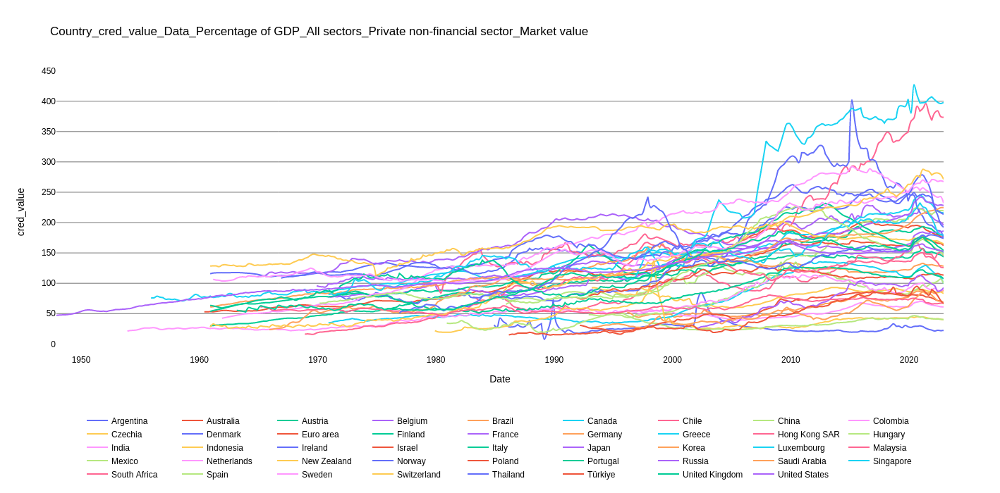

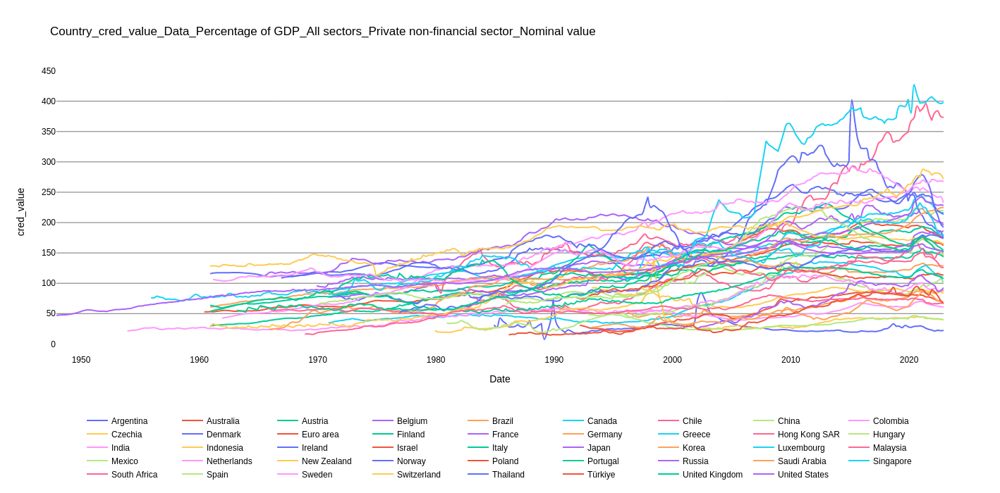

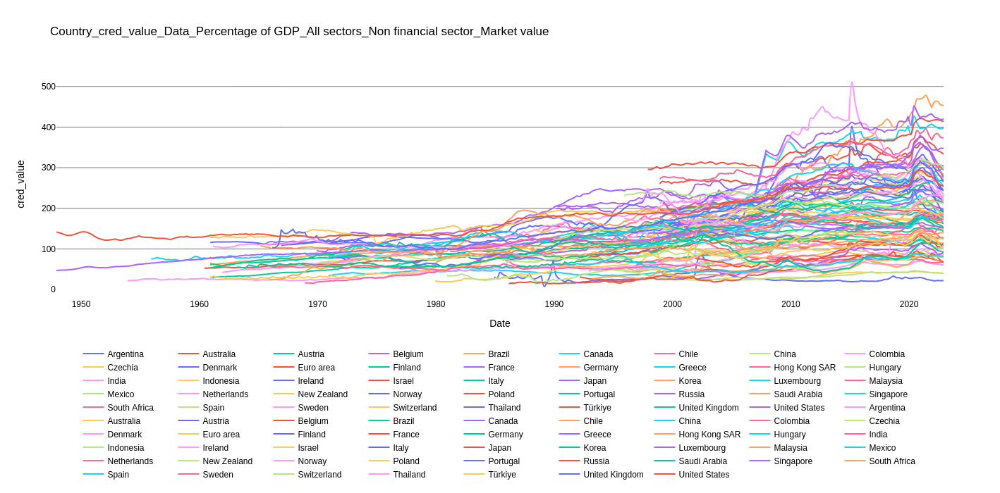

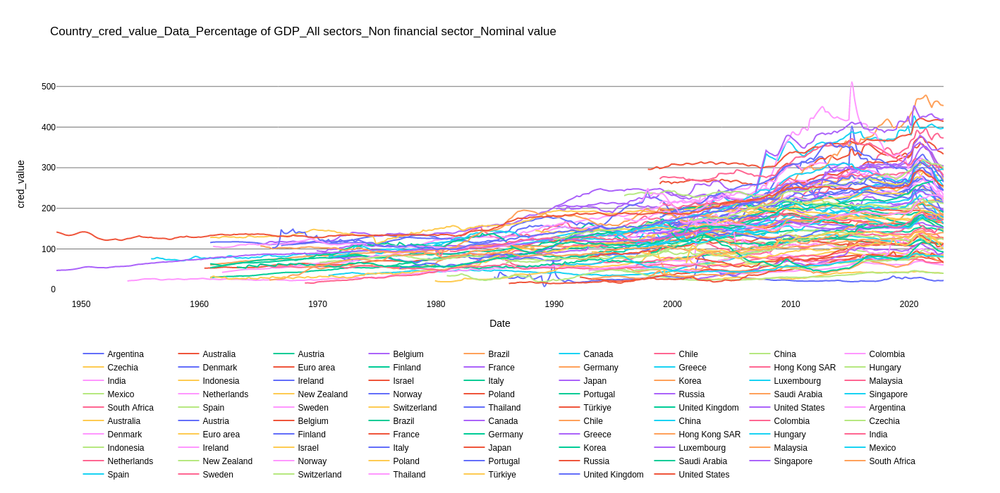

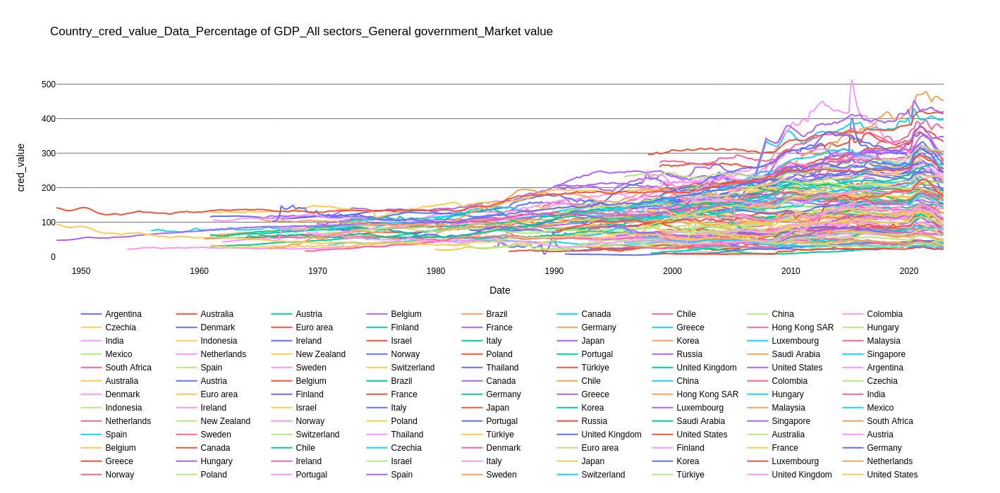

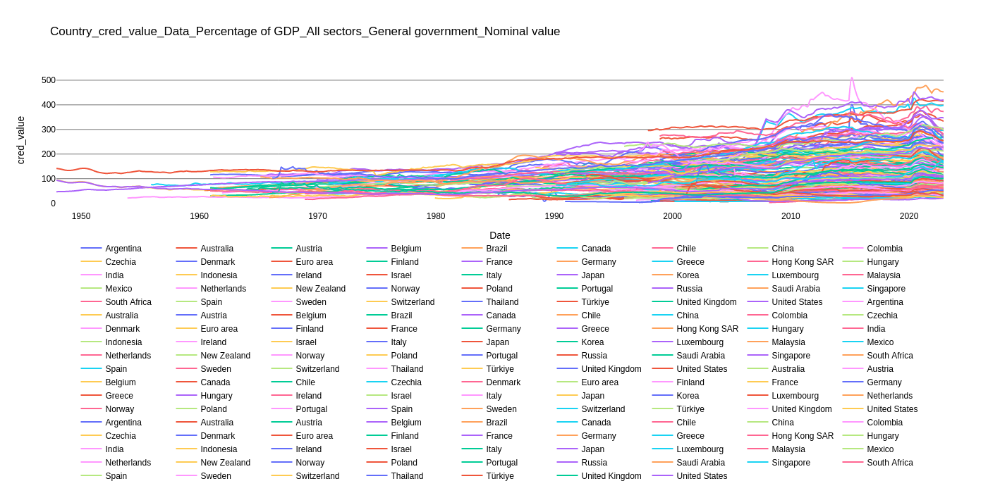

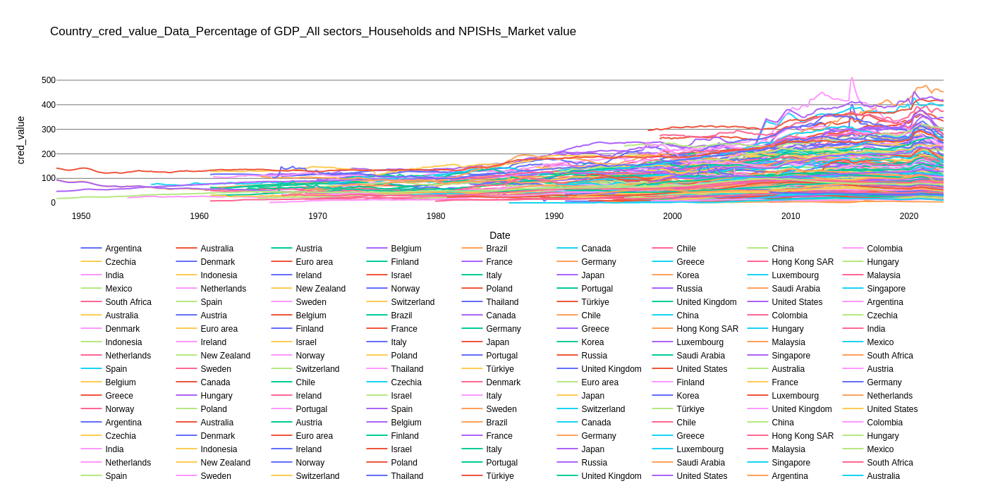

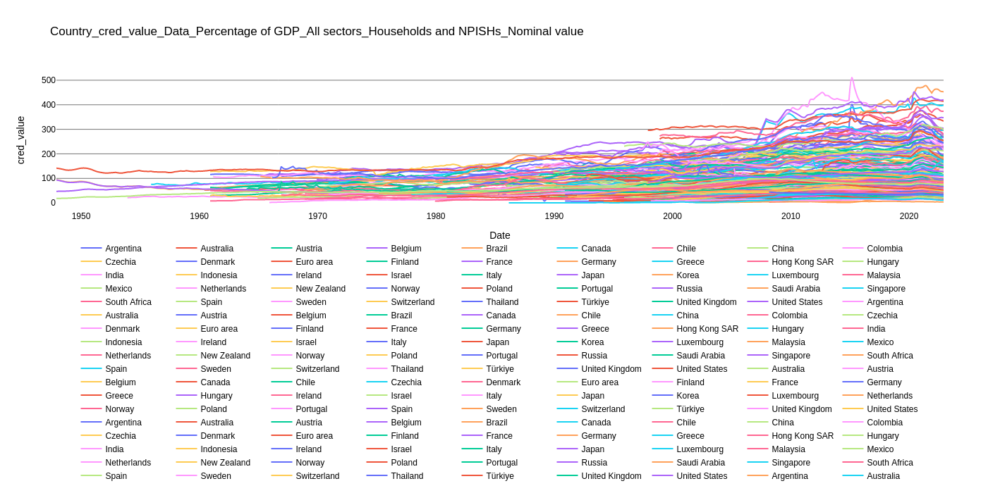

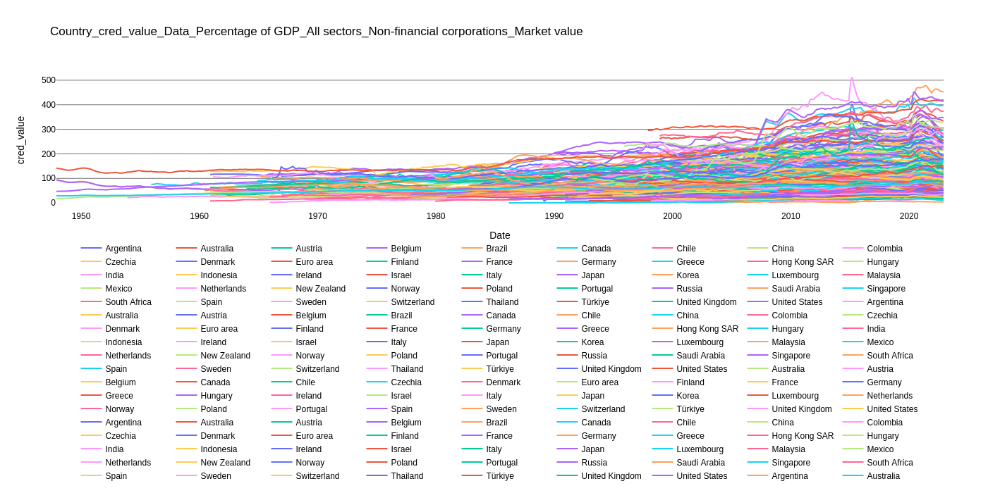

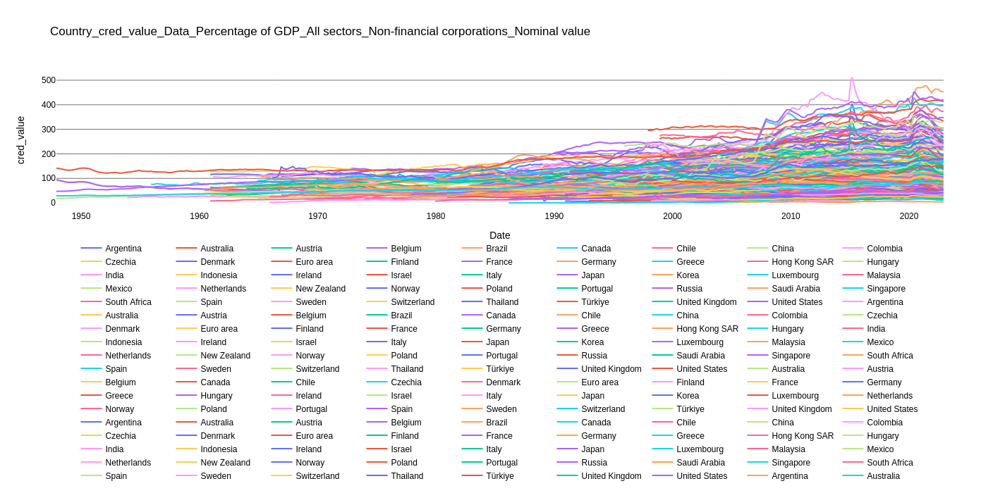

In [63]:
fig = go.Figure()

x = 'cpi_date_prior_month'
y = 'cred_value'

valuation_method = 'Market value'

unique_vals = sorted(p_cred_stack_pct_df2['country_name'].dropna().unique())

for borrow in borrwing_sectors:

    for valuation in valuation_methods:

        PLOT_FILENAME = 'Country_%s_Data_%s_%s_%s_%s' %(y, unit_type, lending_sector, borrow, valuation)
    
        for i in unique_vals:
            
            f = p_cred_stack_pct_df2[p_cred_stack_pct_df2['country_name'] == i]
            f = f[f['valuation_method'] == valuation]
            f = f[f['borrowing_sector'] == borrow]
            
            title = i
            f = f.sort_values(by=x, ascending=True)
            
            fig.add_trace(go.Scatter(x=f[x], y=f[y], mode='lines', name=title, 
                                     # line=line_dict,
                                     line_shape='spline',
                                     # hover_data=["p_day", "audio_combined"],
                                     # hovertemplate ='<i>Streams</i>: %{y:.2f}'+ '<br><b>Week</b>: %{x}<br>' + '<b>%{text}</b>',
                                     # text = ['Date: {}'.format(str(i.strftime('%d-%b-%Y'))) for i in f.p_day_mod],
                                    ),
                             )
        
        # fig.update_traces(mode="lines")
        
        fig.update_layout(showlegend=True,

                          title=PLOT_FILENAME,
                        #   hovermode="x",
                        hovermode='closest',
                        paper_bgcolor="white", plot_bgcolor="white",
                        font_color='black',
                        xaxis={'title': {'text': 'Date'}, 'showgrid': False, 
                               # 'tickmode': 'linear', 'tick0': 0, 'dtick': 1
                              },
                        yaxis={'title': {'text': '%s' %(y)}, 'showgrid': True, 'gridwidth': 0.9, 'gridcolor':'#666666'},
        
                         )
        
        fig.update_layout(height=700,
                         legend=dict(orientation='h', xanchor="center", x=0.5, y=-0.2),
                         )
        
        output_fp = os.path.join(kwargs['plots_dir'], PLOT_FILENAME)
        fig.write_html(output_fp+'_BIS.html')
        
        fig.show()

### Inflation

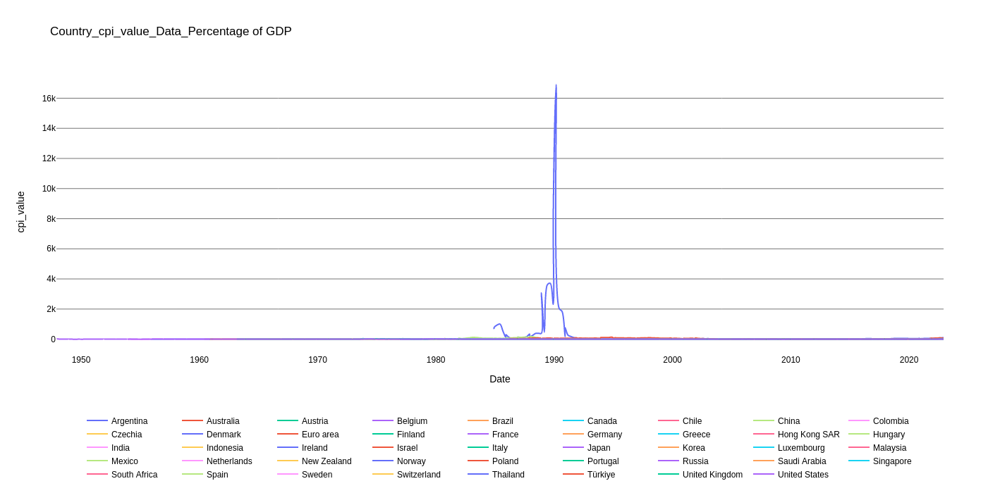

In [64]:
fig = go.Figure()

x = 'cpi_date_prior_month'
y = 'cpi_value'

valuation_method = 'Market value'

unique_vals = sorted(p_cred_stack_pct_df2['country_name'].dropna().unique())

PLOT_FILENAME = 'Country_%s_Data_%s' %(y, unit_type,)

for i in unique_vals:
    
    f = p_cred_stack_pct_df2[p_cred_stack_pct_df2['country_name'] == i]
    
    title = i
    f = f.sort_values(by=x, ascending=True)
    
    fig.add_trace(go.Scatter(x=f[x], y=f[y], mode='lines', name=title, 
                             # line=line_dict,
                             line_shape='spline',
                             # hover_data=["p_day", "audio_combined"],
                             # hovertemplate ='<i>Streams</i>: %{y:.2f}'+ '<br><b>Week</b>: %{x}<br>' + '<b>%{text}</b>',
                             # text = ['Date: {}'.format(str(i.strftime('%d-%b-%Y'))) for i in f.p_day_mod],
                            ),
                     )

# fig.update_traces(mode="lines")

fig.update_layout(showlegend=True,

                  title=PLOT_FILENAME,
                #   hovermode="x",
                hovermode='closest',
                paper_bgcolor="white", plot_bgcolor="white",
                font_color='black',
                xaxis={'title': {'text': 'Date'}, 'showgrid': False, 
                       # 'tickmode': 'linear', 'tick0': 0, 'dtick': 1
                      },
                yaxis={'title': {'text': '%s' %(y)}, 'showgrid': True, 'gridwidth': 0.9, 'gridcolor':'#666666'},

                 )

fig.update_layout(height=700,
                 legend=dict(orientation='h', xanchor="center", x=0.5, y=-0.2),
                 )

output_fp = os.path.join(kwargs['plots_dir'], PLOT_FILENAME)
fig.write_html(output_fp+'_BIS.html')

fig.show()

## Merge with the central bank policy

In [65]:
m_cb_df = m_cb_df.rename(columns={'obs_value:observation value': 'cb_loan_rate_value'})

In [66]:
# Merge cpi data on to p_Cred_stack
sliced = m_cb_df[['cb_period_year', 'cb_period_month','country_name', 'cb_loan_rate_value',]]
before = p_cred_stack_pct_df2.shape[0]
p_cred_stack_pct_df3 = p_cred_stack_pct_df2.merge(sliced, left_on=['pcred_end_period_year', 'pcred_end_period_month', 'borrower_country_name'],
                                        right_on=['cb_period_year', 'cb_period_month', 'country_name'], how='left')
after = p_cred_stack_pct_df3.shape[0]
print(before, after)

# Null check
print(p_cred_stack_pct_df3['cb_loan_rate_value'].isnull().sum())

45412 45412
19203


In [67]:
p_cred_stack_pct_df3 = p_cred_stack_pct_df3.rename(columns={'country_name_x': 'country_name'})

In [68]:
p_cred_stack_pct_df3.head(n=3)

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,...,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value,cb_period_year,cb_period_month,country_name_y,cb_loan_rate_value
0,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,...,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436,NaN,NaN,NaN,NaN
1,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,...,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558,NaN,NaN,NaN,NaN
2,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,...,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436,NaN,NaN,NaN,NaN


In [69]:
p_cred_stack_pct_df3[~p_cred_stack_pct_df3['cb_loan_rate_value'].isnull()]

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,...,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value,cb_period_year,cb_period_month,country_name_y,cb_loan_rate_value
108,1951-06-30,Q:IN:P:A:M:770:A,24.9,1951-06-30 00:00:00+00:00,India,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,...,6,NaN,NaT,NaN,NaN,NaN,1951.0,6.0,India,3.0
115,1951-09-30,Q:IN:P:A:M:770:A,23.1,1951-09-30 00:00:00+00:00,India,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,...,9,NaN,NaT,NaN,NaN,NaN,1951.0,9.0,India,3.0
122,1951-12-31,Q:IN:P:A:M:770:A,22.7,1951-12-31 00:00:00+00:00,India,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,...,12,NaN,NaT,NaN,NaN,NaN,1951.0,12.0,India,3.5
135,1952-03-31,Q:IN:P:A:M:770:A,22.9,1952-03-31 00:00:00+00:00,India,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,...,3,NaN,NaT,NaN,NaN,NaN,1952.0,3.0,India,3.5
142,1952-06-30,Q:IN:P:A:M:770:A,23.1,1952-06-30 00:00:00+00:00,India,Quarterly,Percentage of GDP,All sectors,Private non-financial sector,Market value,...,6,NaN,NaT,NaN,NaN,NaN,1952.0,6.0,India,3.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45407,2022-12-31,Q:ZA:C:A:M:770:A,140.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,...,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176,2022.0,12.0,South Africa,7.0
45408,2022-12-31,Q:ZA:G:A:N:770:A,72.8,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,...,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176,2022.0,12.0,South Africa,7.0
45409,2022-12-31,Q:ZA:H:A:M:770:A,34.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Households and NPISHs,Market value,...,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176,2022.0,12.0,South Africa,7.0
45410,2022-12-31,Q:ZA:N:A:M:770:A,33.1,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non-financial corporations,Market value,...,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176,2022.0,12.0,South Africa,7.0


# Time Series Plots

### Focus on a subset of countries

In [70]:
selected_countries = ['United Kingdom',
                      'United States',
                      'Euro area',
                      'Argentina',
                     ]

In [71]:
p_cred_stack_pct_df2

,period,code,cred_value,pcred_end_period,borrower_country_name,frequency,credit_unit_type,lending_sector,borrowing_sector,valuation_method,country_code,pcred_end_period_year,pcred_end_period_month,cpi_year,cpi_date_prior_month,cpi_month,country_name,cpi_value
0,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
1,1947-12-31,Q:US:C:A:M:770:A,141.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
2,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
3,1947-12-31,Q:US:G:A:M:770:A,94.6,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Market value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,10.232558
4,1947-12-31,Q:US:G:A:N:770:A,93.7,1947-12-31 00:00:00+00:00,United States,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,US,1947,12,1947.0,1947-12-01 00:00:00+00:00,12.0,United States,7.689436
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45407,2022-12-31,Q:ZA:C:A:M:770:A,140.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non financial sector,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45408,2022-12-31,Q:ZA:G:A:N:770:A,72.8,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,General government,Nominal value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45409,2022-12-31,Q:ZA:H:A:M:770:A,34.2,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Households and NPISHs,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176
45410,2022-12-31,Q:ZA:N:A:M:770:A,33.1,2022-12-31 00:00:00+00:00,South Africa,Quarterly,Percentage of GDP,All sectors,Non-financial corporations,Market value,ZA,2022,12,2022.0,2022-12-01 00:00:00+00:00,12.0,South Africa,6.886176


In [73]:
# # For creating plotly figures and uploading on to Plotly so that the figures can be hosted on medium.com
# username = os.getenv('PLOTLY_USERNAME')
# api_key = os.getenv('PLOTLY_CHART_API_KEY')

# chart_studio.tools.set_credentials_file(username=username,
#                                         api_key=api_key)

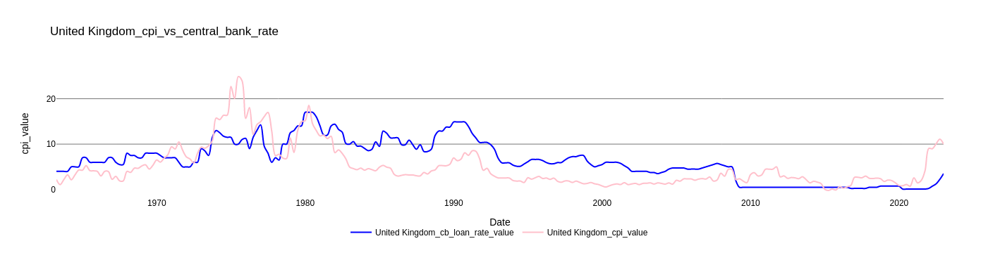

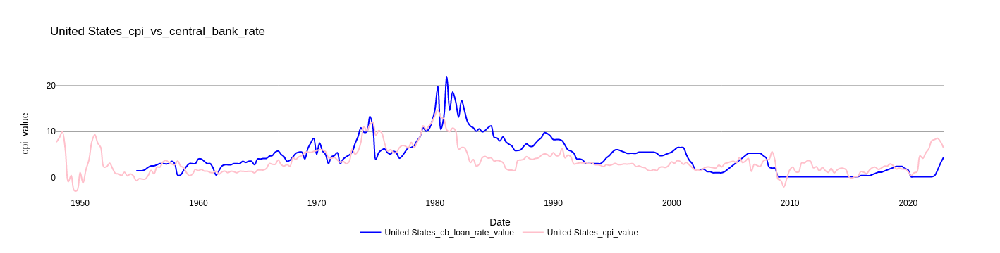

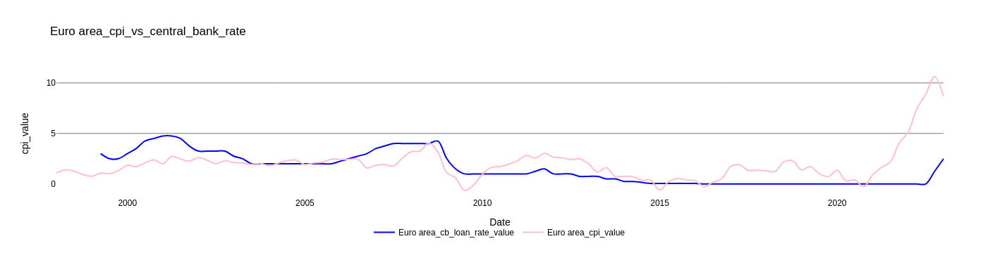

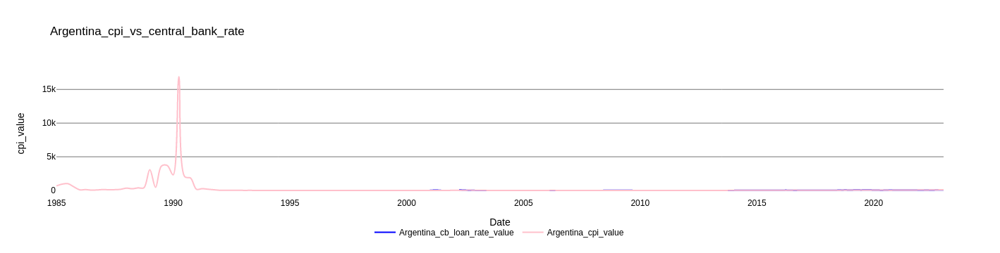

In [74]:
x = 'period'
y = 'cred_value'

valuation_method = 'Market value'

for i in selected_countries:

    fig = go.Figure()
    
    PLOT_FILENAME = '%s_cpi_vs_central_bank_rate' %(i)
    vars = {'cb_loan_rate_value':'blue', 'cpi_value':'pink'}
    
    for y in vars:

        f = p_cred_stack_pct_df3[p_cred_stack_pct_df3['country_name'] == i]
        f = f.groupby(['period']).first().reset_index()
        
        title = '%s_%s' %(i, y)
        f = f.sort_values(by=x, ascending=True)
        
        fig.add_trace(go.Scatter(x=f[x], y=f[y], mode='lines', name=title, 
                                 # line=line_dict,
                                 line=dict(color=vars[y]),
                                 line_shape='spline',
                                 # hover_data=["p_day", "audio_combined"],
                                 # hovertemplate ='<i>Streams</i>: %{y:.2f}'+ '<br><b>Week</b>: %{x}<br>' + '<b>%{text}</b>',
                                 # text = ['Date: {}'.format(str(i.strftime('%d-%b-%Y'))) for i in f.p_day_mod],
                                ),
                         )
    
    # fig.update_traces(mode="lines")
    
    fig.update_layout(showlegend=True,

                    title=PLOT_FILENAME,
                      hovermode="x",
                    # hovermode='closest',
                    paper_bgcolor="white", plot_bgcolor="white",
                    font_color='black',
                    xaxis={'title': {'text': 'Date'}, 'showgrid': False, 
                           # 'tickmode': 'linear', 'tick0': 0, 'dtick': 1
                          },
                    yaxis={'title': {'text': '%s' %(y)}, 'showgrid': True, 'gridwidth': 0.9, 'gridcolor':'#666666'},
    
                     )
    
    fig.update_layout(height=700,
                     legend=dict(orientation='h', xanchor="center", x=0.5, y=-0.2),
                     )
    
    output_fp = os.path.join(kwargs['plots_dir'], PLOT_FILENAME)
    fig.write_html(output_fp+'_BIS.html')
    
    fig.show()

### Plot the UK timeseries

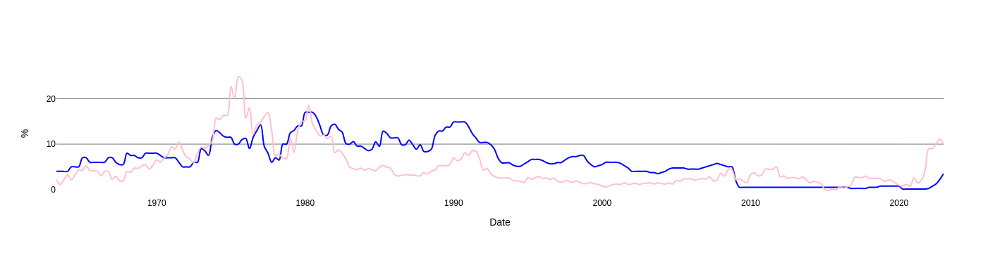

In [75]:
fig = go.Figure()

# PLOT_FILENAME = '%s CPI vs Central Bank Rate' %(country)
vars = {'cb_loan_rate_value':'blue', 'cpi_value':'pink'}
country = 'United Kingdom'
x = 'period'
y = 'cred_value'

valuation_method = 'Market value'

for y in vars:

    f = p_cred_stack_pct_df3[p_cred_stack_pct_df3['country_name'] == country]
    f = f.groupby(['period']).first().reset_index()
    
    title = '%s_%s' %(country, y)
    f = f.sort_values(by=x, ascending=True)
    
    fig.add_trace(go.Scatter(x=f[x], y=f[y], mode='lines', name=title, 
                             # line=line_dict,
                             line=dict(color=vars[y]),
                             line_shape='spline',
                             # hover_data=["p_day", "audio_combined"],
                             # hovertemplate ='<i>Streams</i>: %{y:.2f}'+ '<br><b>Week</b>: %{x}<br>' + '<b>%{text}</b>',
                             # text = ['Date: {}'.format(str(i.strftime('%d-%b-%Y'))) for i in f.p_day_mod],
                            ),
                     )

# fig.update_traces(mode="lines")

fig.update_layout(showlegend=False,

                # title=PLOT_FILENAME,
                  hovermode="x",
                # hovermode='closest',
                paper_bgcolor="white", plot_bgcolor="white",
                font_color='black',
                xaxis={'title': {'text': 'Date'}, 'showgrid': False, 
                       # 'tickmode': 'linear', 'tick0': 0, 'dtick': 1
                      },
                yaxis={'title': {'text': '%' }, 'showgrid': True, 'gridwidth': 0.9, 'gridcolor':'#666666'},

                 )

config = {
    'displayModeBar': True,  # Display the modebar
    'scrollZoom': True,  # Allow scroll zoom
    'modeBarButtonsToAdd': ['pan2d', 'resetScale2d'],  # Add pan and reset axis tools
    'modeBarButtonsToRemove': ['zoom2d', 'zoomIn2d', 'zoomOut2d', 'autoScale2d', 'resetViews', 'toggleSpikelines'],  # Remove other tools
}

# Show figure
fig.show(config=config)


# plot_py.plot(fig, filename="plotly_scatter", auto_open=True, config=config)

# OLS Test of inflation against interest rates

 Here we use the difference (or velocity) of interest rates vs the velocity of inflation to understand effects

In [76]:
# Test Different date ranges:

min_date = '1970-01-01'
# min_date = '2005-01-01'

# max_date = datetime.today().strftime('%Y-%m-%d')
max_date = '2008-01-01'

In [77]:
int_df = p_cred_stack_pct_df3.groupby(['country_name','period']).first().reset_index()

# Filter data on selected date range:
int_df = int_df[(int_df['period'] >= min_date) & (int_df['period'] <= max_date)].copy()

In [78]:
# Calculate the CPI diffference for each period, 2 quarters and 1 year. This should be more than enough to capture significant policy making by central banks
int_df['cpi_value_diff'] = int_df.groupby(['country_name',])['cpi_value'].diff()
int_df['cpi_value_2Q_diff'] = int_df.groupby(['country_name',])['cpi_value'].diff(2)
int_df['cpi_value_4Q_diff'] = int_df.groupby(['country_name',])['cpi_value'].diff(4)

# Calculate the interest rate diffference for each period
int_df['cb_loan_rate_value_diff'] = int_df.groupby(['country_name',])['cb_loan_rate_value'].diff()
int_df['cb_loan_rate_value_2Q_diff'] = int_df.groupby(['country_name',])['cb_loan_rate_value'].diff(2)
int_df['cb_loan_rate_value_4Q_diff'] = int_df.groupby(['country_name',])['cb_loan_rate_value'].diff(4)

In [129]:
# First create lag features, noting how it may take time for interest rates to take effect:
shifted_interest_rate = [-4,-2, -1, 0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24]

for i in shifted_interest_rate:

    int_df['cb_loan_rate_value_diff_shift_%s' %(i)] = int_df['cb_loan_rate_value_diff'].shift(i)
    int_df['cb_loan_rate_value_2Q_diff_shift_%s' %(i)] = int_df['cb_loan_rate_value_2Q_diff'].shift(i)
    int_df['cb_loan_rate_value_4Q_diff_shift_%s' %(i)] = int_df['cb_loan_rate_value_4Q_diff'].shift(i)
    

    # int_df['cb_loan_shift_diff_%s' %(i)] = int_df.groupby(['country_name',])['cb_loan_shift_%s' %(i)].diff()

### Quick QC

In [130]:
int_df[int_df['country_name'] == 'United States'][['period', 'frequency', 'cb_loan_rate_value', 'cb_loan_rate_value_diff',  
                                                   'cb_loan_rate_value_2Q_diff', 'cb_loan_rate_value_4Q_diff', 
                                                   'cb_loan_rate_value_diff_shift_1', 'cpi_value', 'cpi_value_diff']]

,period,frequency,cb_loan_rate_value,cb_loan_rate_value_diff,cb_loan_rate_value_2Q_diff,cb_loan_rate_value_4Q_diff,cb_loan_rate_value_diff_shift_1,cpi_value,cpi_value_diff
8380,1970-03-31,Quarterly,7.50,NaN,NaN,NaN,-0.25,6.060606,NaN
8381,1970-06-30,Quarterly,5.75,-1.75,NaN,NaN,NaN,5.978261,-0.082345
8382,1970-09-30,Quarterly,5.00,-0.75,-2.50,NaN,-1.75,5.630027,-0.348234
8383,1970-12-31,Quarterly,3.00,-2.00,-2.75,NaN,-0.75,4.292767,-1.337260
8384,1971-03-31,Quarterly,4.50,1.50,-0.50,-3.0,-2.00,4.155844,-0.136923
...,...,...,...,...,...,...,...,...,...
8527,2006-12-31,Quarterly,5.25,0.00,0.00,1.0,0.00,2.852672,1.547451
8528,2007-03-31,Quarterly,5.25,0.00,0.00,0.5,0.00,2.573697,-0.278975
8529,2007-06-30,Quarterly,5.25,0.00,0.00,0.0,0.00,2.358231,-0.215466
8530,2007-09-30,Quarterly,4.75,-0.50,-0.50,-0.5,0.00,3.536174,1.177943


## Correlations and Linear Regression

In [131]:
target_country_name = 'United Kingdom'

In [186]:
# Create a list of correlations for each CPI data point with interest rate differences shifted by n quarters to take in to account the lag effect

correlations2 = []

for lag in shifted_interest_rate:

    # Optional: choose 1 quarterly difference, half a year or yearly interest rate changes:
    # y = 'cb_loan_rate_value_diff_shift_%s' %(lag)
    # y = 'cb_loan_rate_value_2Q_diff_shift_%s' %(lag)
    y_col = 'cpi_value_diff'
    x_col = 'cb_loan_rate_value_4Q_diff_shift_%s' %(lag)

    # Drop any NaN values
    c_int_df = int_df[int_df['country_name'] == target_country_name].copy().dropna(subset=[y_col, x_col])

    # Optional: Filter out periods where there was no change to interest rates
    c_int_df = c_int_df[c_int_df[x_col] != 0].copy()
    
    pearson_corr2, pearson_pval = stats.pearsonr(c_int_df[x_col], c_int_df[y_col])
    
    record = {'Time_Lag': lag, 'Correlation': round(pearson_corr2, 3), 'p_value': round(pearson_pval, 3), 'r_squared': round((pearson_corr2**2), 3)}
    

    # get the intercepts and coeeficinets to calculate what the expected drop might be:

    # Extract the independent variable (X) and dependent variable (y)
    x_data = c_int_df[x_col].values
    y_data = c_int_df[y_col].values

    # Add a constant term for the intercept
    X_with_const = sm.add_constant(x_data)
    
    # Fit a linear regression model using statsmodels for p-values
    model_with_const = sm.OLS(y_data, X_with_const).fit()
    intercept = model_with_const.params[0]
    coefficient_x = model_with_const.params[1]
    
    p_value_intercept = model_with_const.pvalues[0]
    p_value_coeff = model_with_const.pvalues[1]
    
    record['lr_coefficient'] = coefficient
    record['lr_coefficient_pval'] = p_value_coeff
    record['lr_intercept'] = intercept
    record['lr_intercept_pval'] = p_value_intercept

    correlations2.append(record)

In [187]:
model_with_const.params

array([0.00530292, 0.02713789])

In [188]:
model_with_const.pvalues

array([0.97038331, 0.39556393])

In [189]:
model_with_const.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                 -0.002
Method:                 Least Squares   F-statistic:                    0.7263
Date:                Mon, 13 Nov 2023   Prob (F-statistic):              0.396
Time:                        21:05:51   Log-Likelihood:                -265.17
No. Observations:                 139   AIC:                             534.3
Df Residuals:                     137   BIC:                             540.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0053      0.143      0.037      0.970      -0.277       0.287
x1             0.0271      0.032      0.852      0.396      -0.036       0.090
==============================================================================
Omnibus:                       34.711   Durbin-Watson:                   2.244
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              330.996
Skew:                          -0.401   Prob(JB):                     1.33e-72
Kurtosis:                      10.517   Cond. No.                         4.59
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [190]:
# Convert correlations to DataFrame for easier manipulation
# correlation_df = pd.DataFrame(correlations, columns=['Time_Lag', 'Correlation'])
correlation_df2 = pd.DataFrame(correlations2,)

# Find the lag with the highest correlation
best_max_correlation = correlation_df2['Correlation'].max()
best_max_lag = correlation_df2['Time_Lag'][correlation_df2['Correlation'].idxmax()]

best_min_correlation = correlation_df2['Correlation'].min()
best_min_lag = correlation_df2['Time_Lag'][correlation_df2['Correlation'].idxmin()]

print("\nBest Max Correlation:", best_max_correlation)
print("Best Time Lag:", best_max_lag)

print('\n')
    
print("Best Min Correlation:", best_min_correlation)
print("Best Time Lag:", best_min_lag)


Best Max Correlation: 0.311
Best Time Lag: 1


Best Min Correlation: -0.202
Best Time Lag: 14


In [191]:
correlation_df2

,Time_Lag,Correlation,p_value,r_squared,lr_coefficient,lr_coefficient_pval,lr_intercept,lr_intercept_pval
0,-4,-0.006,0.943,0.000,0.194329,0.943473,-0.046672,0.749717
1,-2,0.125,0.139,0.016,0.194329,0.139278,-0.024052,0.867623
2,-1,0.273,0.001,0.075,0.194329,0.000993,-0.027054,0.846763
3,0,0.274,0.001,0.075,0.194329,0.000986,-0.029404,0.833556
4,1,0.311,0.000,0.097,0.194329,0.000173,-0.097762,0.457340
5,2,0.234,0.005,0.055,0.194329,0.005298,-0.024576,0.861281
6,3,0.123,0.148,0.015,0.194329,0.147778,-0.055404,0.693395
7,4,0.096,0.257,0.009,0.194329,0.256856,0.003643,0.979992
8,5,0.018,0.830,0.000,0.194329,0.829911,0.044483,0.738099
9,6,-0.135,0.109,0.018,0.194329,0.109375,-0.049183,0.723893


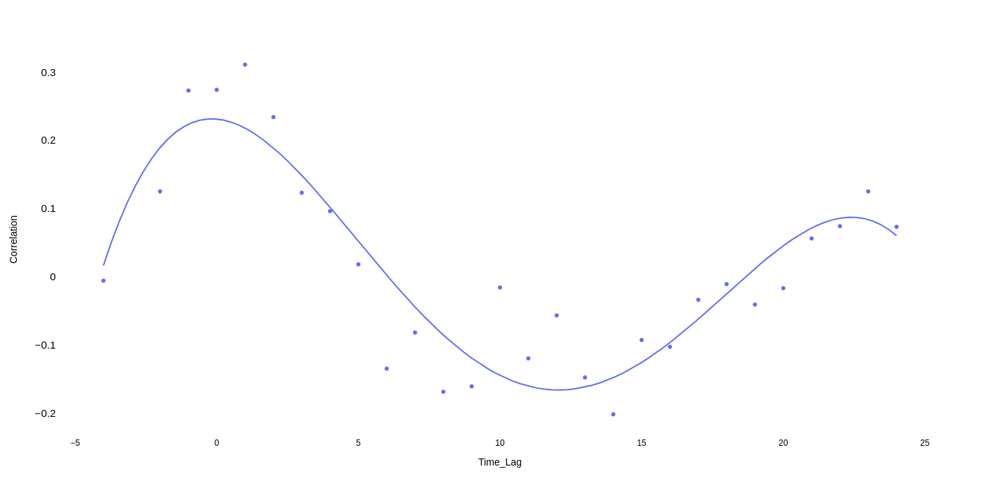

In [192]:
x = 'Time_Lag'
y = 'Correlation'


fig = px.scatter(correlation_df2,
                 x=x,
                 y=y,
                )

# Fit a quadratic curve (second-degree polynomial)
coefficients = np.polyfit(correlation_df2['Time_Lag'], correlation_df2['Correlation'], 4)
quadratic_curve = np.poly1d(coefficients)

# Generate x-values for the quadratic curve
x_curve = np.linspace(min(correlation_df2['Time_Lag']), max(correlation_df2['Time_Lag']), 100)
y_curve = quadratic_curve(x_curve)
line_fig = px.line(x=x_curve, y=y_curve, labels={'x': 'X', 'y': 'Quadratic Curve'})

fig = fig.add_trace(line_fig.data[0])



fig.update_layout(
                  height=700, yaxis = dict(tickfont = dict(size=15),), 
                  paper_bgcolor="white", plot_bgcolor="white",
                  font_color='black',
                 )

fig.show()

### Calculate Inflation Difference for a Given Interest Rate Hike

In [193]:
interest_rate_hike = 0.03
correlation_df2['interest_rate_hike'] = interest_rate_hike

correlation_df2['inflation_diff_yhat'] = (correlation_df2['interest_rate_hike'] * correlation_df2['lr_coefficient']) + correlation_df2['lr_intercept']

In [194]:
correlation_df2

,Time_Lag,Correlation,p_value,r_squared,lr_coefficient,lr_coefficient_pval,lr_intercept,lr_intercept_pval,interest_rate_hike,inflation_diff_yhat
0,-4,-0.006,0.943,0.000,0.194329,0.943473,-0.046672,0.749717,0.03,-0.040842
1,-2,0.125,0.139,0.016,0.194329,0.139278,-0.024052,0.867623,0.03,-0.018222
2,-1,0.273,0.001,0.075,0.194329,0.000993,-0.027054,0.846763,0.03,-0.021224
3,0,0.274,0.001,0.075,0.194329,0.000986,-0.029404,0.833556,0.03,-0.023574
4,1,0.311,0.000,0.097,0.194329,0.000173,-0.097762,0.457340,0.03,-0.091932
5,2,0.234,0.005,0.055,0.194329,0.005298,-0.024576,0.861281,0.03,-0.018746
6,3,0.123,0.148,0.015,0.194329,0.147778,-0.055404,0.693395,0.03,-0.049575
7,4,0.096,0.257,0.009,0.194329,0.256856,0.003643,0.979992,0.03,0.009473
8,5,0.018,0.830,0.000,0.194329,0.829911,0.044483,0.738099,0.03,0.050313
9,6,-0.135,0.109,0.018,0.194329,0.109375,-0.049183,0.723893,0.03,-0.043353


In [195]:
correlation_df2[(correlation_df2['Time_Lag'] >= -4) & (correlation_df2['Time_Lag'] <= 18 )]['inflation_diff_yhat'].sum()

-0.7681340082111662

## Plot Linear Regresssion for Specific Time Lags and Selected Countries

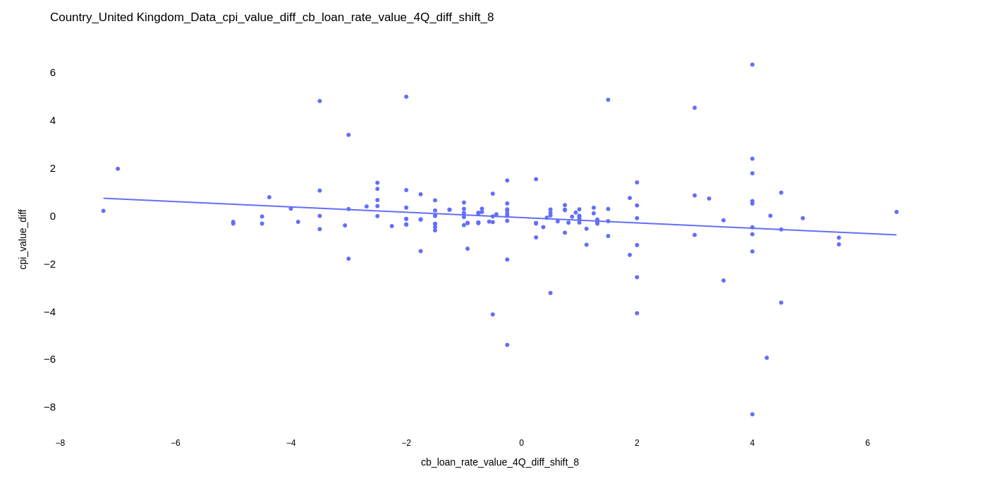

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.022
Method:                 Least Squares   F-statistic:                     4.093
Date:                Mon, 13 Nov 2023   Prob (F-statistic):             0.0450
Time:                        20:07:36   Log-Likelihood:                -273.32
No. Observations:                 141   AIC:                             550.6
Df Residuals:                     139   BIC:                             556.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0650      0.143     -0.456      0.6

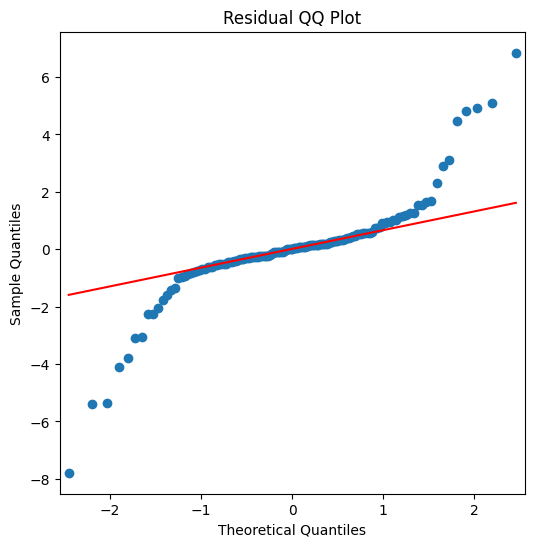

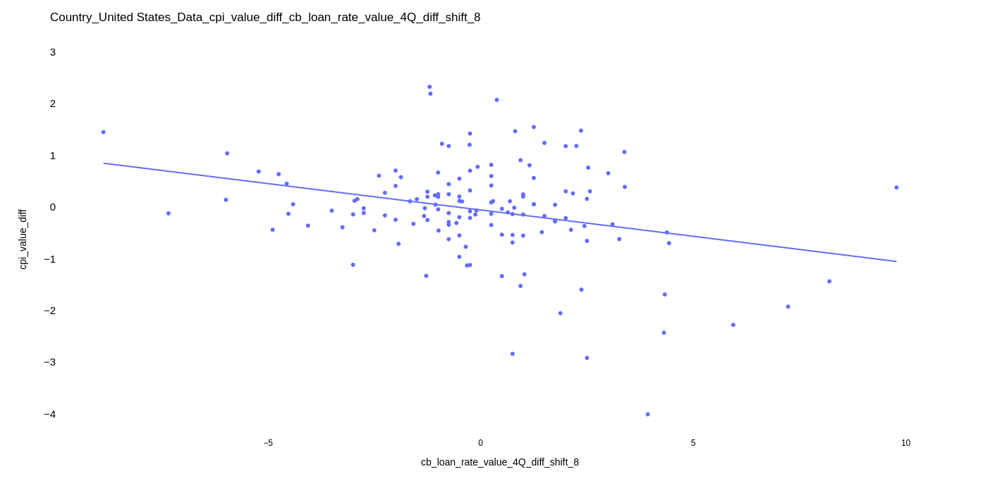

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.084
Model:                            OLS   Adj. R-squared:                  0.078
Method:                 Least Squares   F-statistic:                     12.72
Date:                Mon, 13 Nov 2023   Prob (F-statistic):           0.000498
Time:                        20:07:36   Log-Likelihood:                -184.34
No. Observations:                 140   AIC:                             372.7
Df Residuals:                     138   BIC:                             378.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0576      0.077     -0.749      0.4

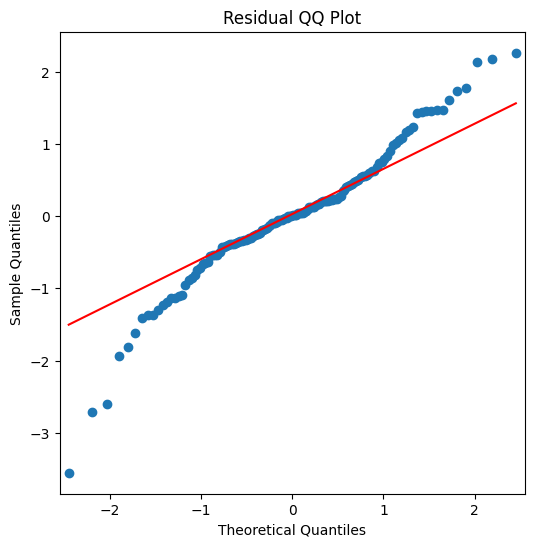

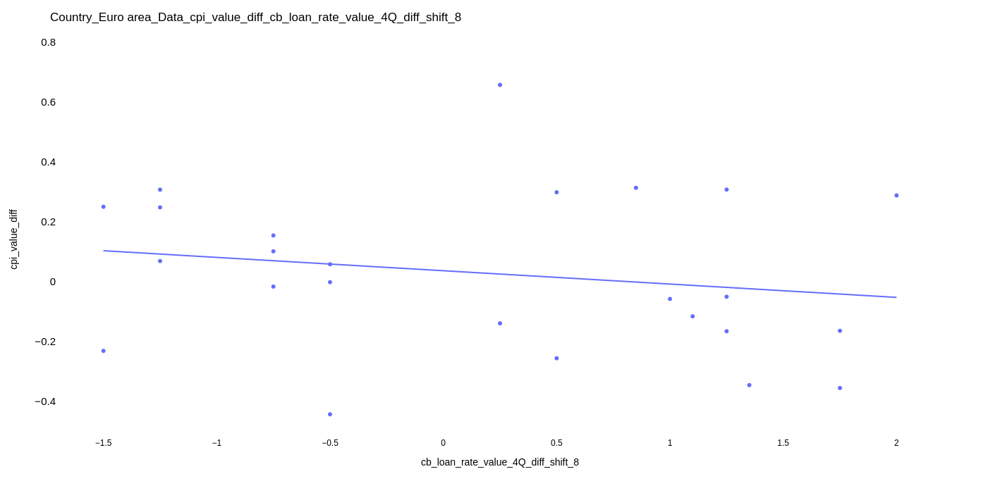

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.036
Model:                            OLS   Adj. R-squared:                 -0.006
Method:                 Least Squares   F-statistic:                    0.8625
Date:                Mon, 13 Nov 2023   Prob (F-statistic):              0.363
Time:                        20:07:37   Log-Likelihood:                -1.3649
No. Observations:                  25   AIC:                             6.730
Df Residuals:                      23   BIC:                             9.168
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0369      0.054      0.684      0.5

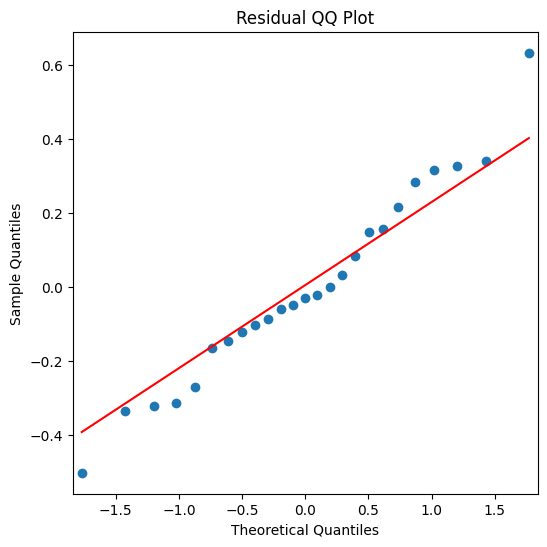

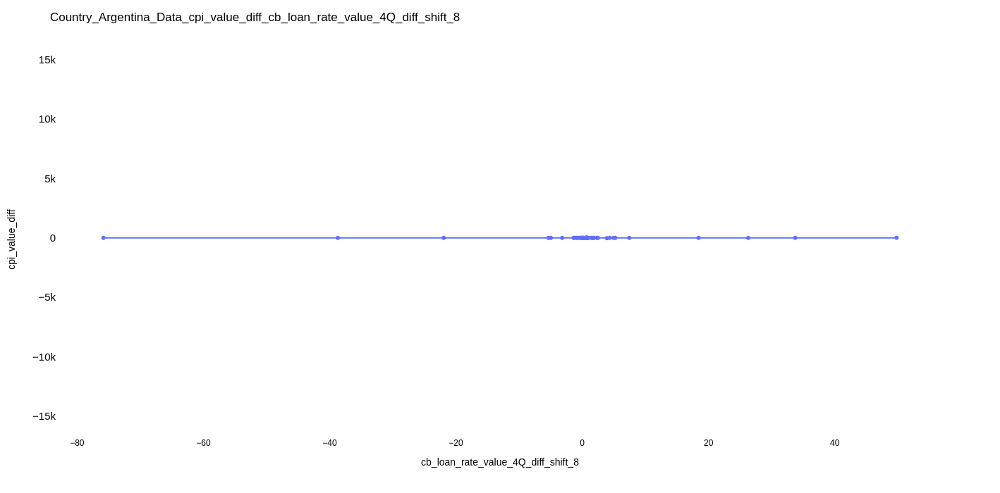

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                 -0.021
Method:                 Least Squares   F-statistic:                    0.1036
Date:                Mon, 13 Nov 2023   Prob (F-statistic):              0.749
Time:                        20:07:37   Log-Likelihood:                -148.74
No. Observations:                  45   AIC:                             301.5
Df Residuals:                      43   BIC:                             305.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0882      1.006      0.088      0.9

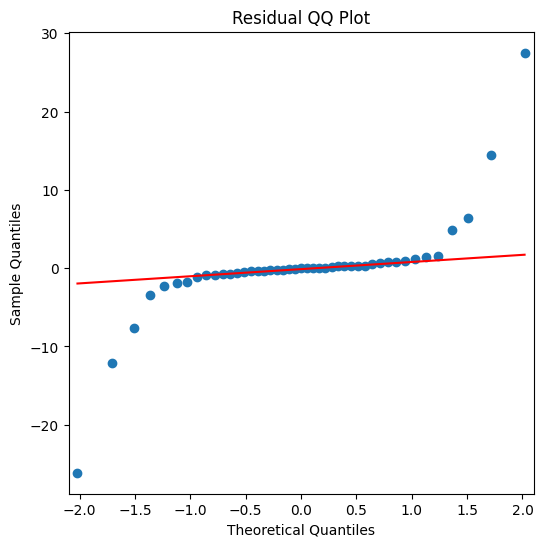

In [136]:
lag = 8
# x = 'cb_loan_rate_value_diff_shift_%s' %(lag)
x = 'cb_loan_rate_value_4Q_diff_shift_%s' %(lag)
y = 'cpi_value_diff'

for i in selected_countries:

    PLOT_FILENAME = 'Country_%s_Data_%s_%s' %(i, y, x)
    title = PLOT_FILENAME
    f = int_df[int_df['country_name'] == i]

    # Calculate 1% and 99% quantiles
    q1 = f[y].quantile(0.01)
    q99 = f[y].quantile(0.99)
    
    # Filter out rows that are below 1% or above 99%
    # f = f[(f[y] >= q1) & (f[y] <= q99)].copy()

    # Remove the comment on this line in order to strip out periods where there were no itnerest rate changes:
    f = f[f[x] != 0]
    
    title = PLOT_FILENAME

    fig = px.scatter(f,
                     x=x,
                     y=y,
                     # facet_col="borrowing_sector",
                     # color="country_name",
                     trendline="ols",
                     # hoverinfo='artist_track',
                     # hover_name="artist_track", 
                     hover_data=["pcred_end_period",'country_name','borrowing_sector','valuation_method'
                                ]
                     # trendline_options=dict(log_x=True),
                    )
    
    
    fig.update_layout(title=title,
                      height=700, yaxis = dict(tickfont = dict(size=15),), 
                      paper_bgcolor="white", plot_bgcolor="white",
                      font_color='black',
                     )
    
    fig.show()
    
    results = px.get_trendline_results(fig)

    summary = results.iloc[0].values[0].summary()
    print(summary)


    # Now plot the residuals to assess for normality

    residuals = results['px_fit_results'].iloc[0].resid

    # Create a QQ plot for the residuals
    fig, ax = plt.subplots(figsize=(6, 6))
    sm.qqplot(residuals, line='q', ax=ax)
    ax.set_title('Residual QQ Plot')
    plt.show()


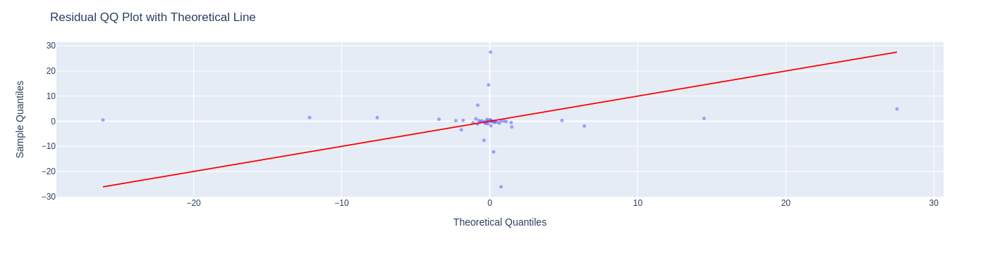